In [ ]:
from google.colab import drive
drive.mount('/content/drive')



Mounted at /content/drive


In [1]:
lora_paths = {
    "healthy": "/HealthyLast.safetensors",
    "bengin": "/BenginLast.safetensors",
    "malignant": "/MalignantLast.safetensors"
}


SyntaxError: (unicode error) 'unicodeescape' codec can't decode bytes in position 2-3: truncated \UXXXXXXXX escape (1065552814.py, line 1)

In [ ]:
!pip uninstall -y torch torchvision torchaudio
!pip install torch==2.1.2 torchvision==0.16.2 torchaudio==2.1.2 --index-url https://download.pytorch.org/whl/cu121
!pip install diffusers transformers accelerate safetensors xformers


Found existing installation: torch 2.6.0+cu124
Uninstalling torch-2.6.0+cu124:
  Successfully uninstalled torch-2.6.0+cu124
Found existing installation: torchvision 0.21.0+cu124
Uninstalling torchvision-0.21.0+cu124:
  Successfully uninstalled torchvision-0.21.0+cu124
Found existing installation: torchaudio 2.6.0+cu124
Uninstalling torchaudio-2.6.0+cu124:
  Successfully uninstalled torchaudio-2.6.0+cu124
Looking in indexes: https://download.pytorch.org/whl/cu121
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 GB 1.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.8/6.8 MB 107.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.3/3.3 MB 89.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 89.2/89.2 MB 24.5 MB/s eta 0:00:00
  Attempting uninstall: triton
    Found existing installation: triton 3.2.0
    Uninstalling triton-3.2.0:
      Successfully uninstalled triton-3.2.0
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.4/43.4 MB 52.1 M

In [ ]:
from huggingface_hub import login
login()

In [ ]:
from diffusers import StableDiffusionPipeline
import torch

pipe = StableDiffusionPipeline.from_pretrained(
    "runwayml/stable-diffusion-v1-5",
    torch_dtype=torch.float16
).to("cuda")


/usr/local/lib/python3.11/dist-packages/torchvision/io/image.py:13: UserWarning: Failed to load image Python extension: '/usr/local/lib/python3.11/dist-packages/torchvision/image.so: undefined symbol: _ZN3c1017RegisterOperatorsD1Ev'If you don't plan on using image functionality from `torchvision.io`, you can ignore this warning. Otherwise, there might be something wrong with your environment. Did you have `libjpeg` or `libpng` installed before building `torchvision` from source?
  warn(
/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warni

model_index.json:   0%|          | 0.00/541 [00:00<?, ?B/s]

Fetching 15 files:   0%|          | 0/15 [00:00<?, ?it/s]

model.safetensors:   0%|          | 0.00/1.22G [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/492M [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/342 [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/4.72k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/617 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

scheduler_config.json:   0%|          | 0.00/308 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/806 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

config.json:   0%|          | 0.00/743 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/3.44G [00:00<?, ?B/s]

config.json:   0%|          | 0.00/547 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [ ]:
from safetensors.torch import load_file

def apply_lora(pipe, lora_path):
    pipe.load_lora_weights(lora_path)  # just pass the path directly
    pipe.fuse_lora()


In [ ]:
prompts = {
    #you can add more to each prompt over here is where we would have a frontend in place to clean things up
    "healthy": "Normal lung CT scan",
    "bengin": "Bengin lung CT scan",
    "malignant": "Malignant lung CT scan"
}



🔄 Applying LoRA model: healthy


  0%|          | 0/50 [00:00<?, ?it/s]

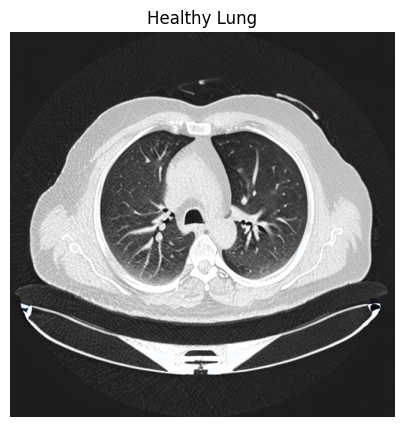


🔄 Applying LoRA model: bengin


  0%|          | 0/50 [00:00<?, ?it/s]

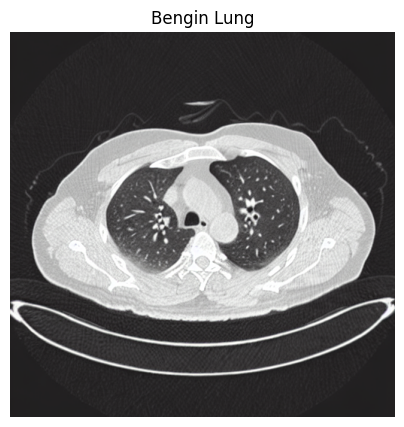


🔄 Applying LoRA model: malignant


  0%|          | 0/50 [00:00<?, ?it/s]

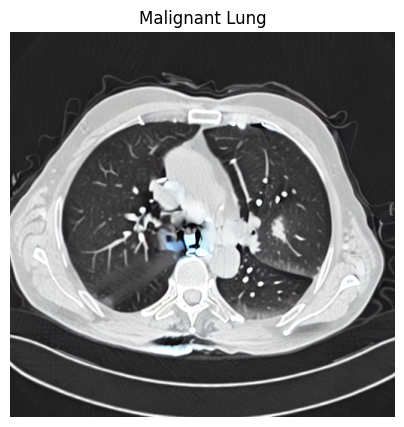

In [ ]:
import matplotlib.pyplot as plt
#Generates 1 image for each
for label, path in lora_paths.items():
    print(f"\n🔄 Applying LoRA model: {label}")

    # Reset base model before applying new LoRA
    pipe.unfuse_lora()
    apply_lora(pipe, path)

    prompt = prompts[label]
    image = pipe(prompt, num_inference_steps=50, guidance_scale=5.5).images[0]

    plt.figure(figsize=(5, 5))
    plt.imshow(image)
    plt.axis("off")
    plt.title(f"{label.capitalize()} Lung")
    plt.show()



🔄 Applying LoRA model: healthy
📸 Generating image 1/10 for healthy


  0%|          | 0/50 [00:00<?, ?it/s]

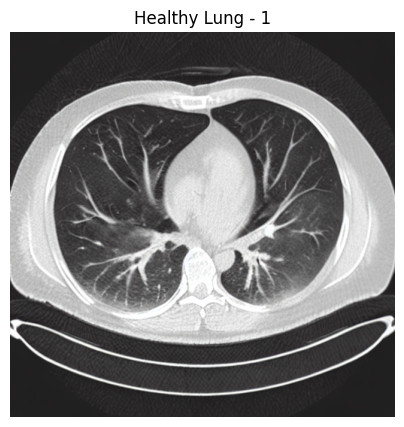

📸 Generating image 2/10 for healthy


  0%|          | 0/50 [00:00<?, ?it/s]

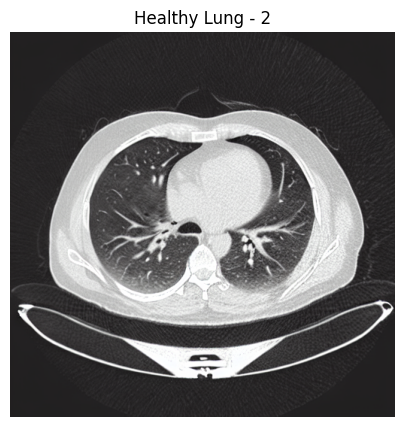

📸 Generating image 3/10 for healthy


  0%|          | 0/50 [00:00<?, ?it/s]

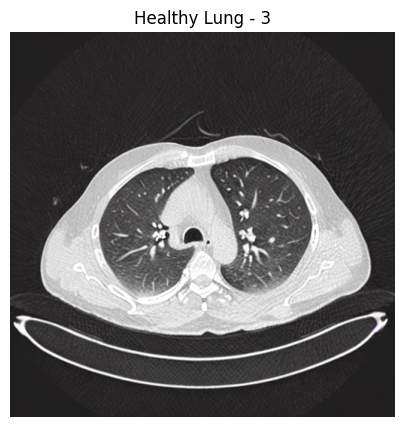

📸 Generating image 4/10 for healthy


  0%|          | 0/50 [00:00<?, ?it/s]

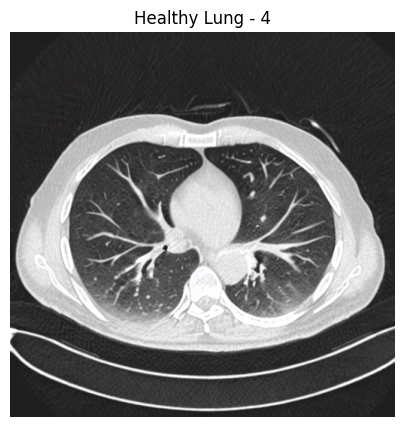

📸 Generating image 5/10 for healthy


  0%|          | 0/50 [00:00<?, ?it/s]

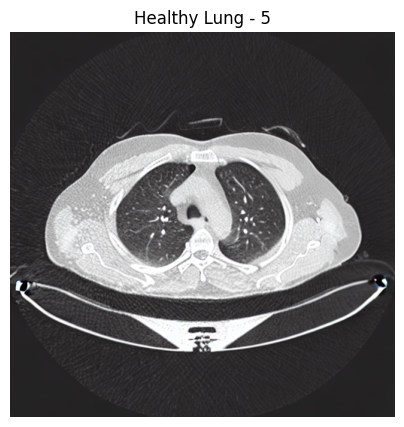

📸 Generating image 6/10 for healthy


  0%|          | 0/50 [00:00<?, ?it/s]

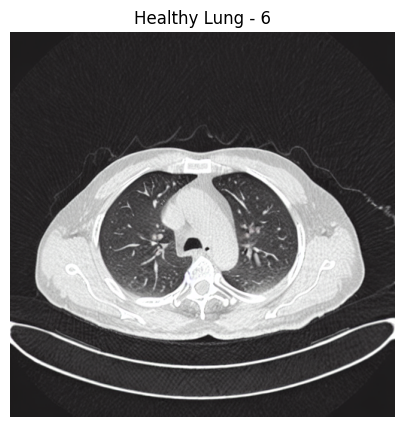

📸 Generating image 7/10 for healthy


  0%|          | 0/50 [00:00<?, ?it/s]

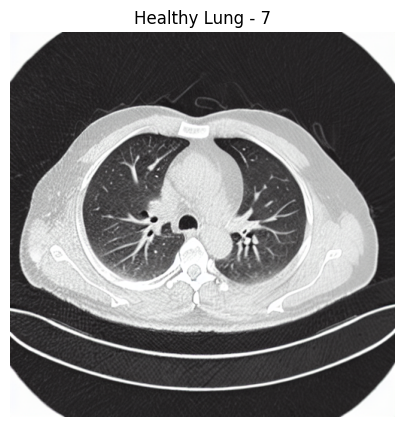

📸 Generating image 8/10 for healthy


  0%|          | 0/50 [00:00<?, ?it/s]

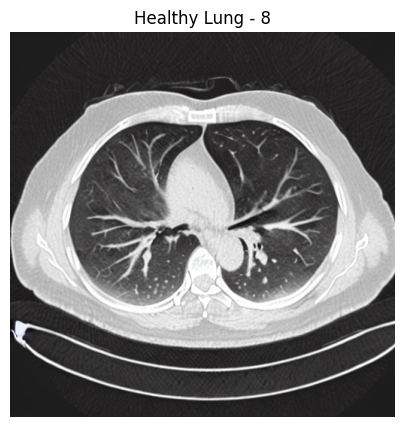

📸 Generating image 9/10 for healthy


  0%|          | 0/50 [00:00<?, ?it/s]

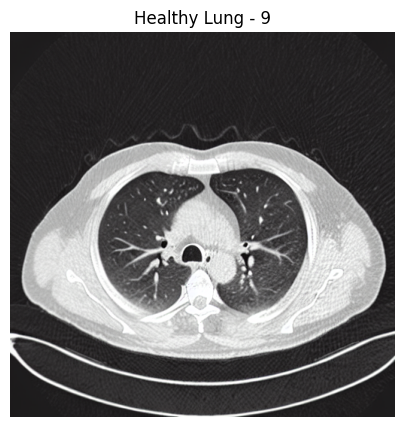

📸 Generating image 10/10 for healthy


  0%|          | 0/50 [00:00<?, ?it/s]

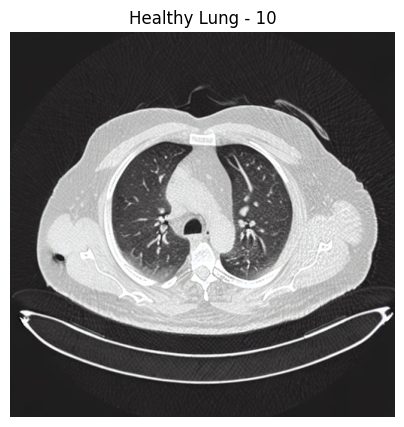


🔄 Applying LoRA model: bengin
📸 Generating image 1/10 for bengin


  0%|          | 0/50 [00:00<?, ?it/s]

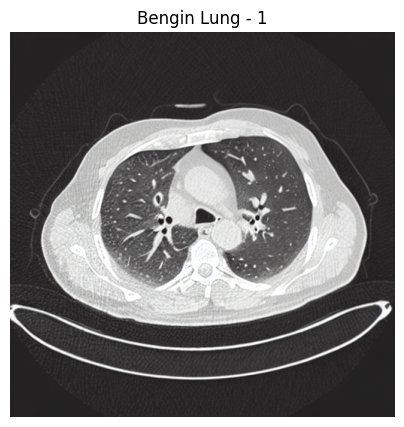

📸 Generating image 2/10 for bengin


  0%|          | 0/50 [00:00<?, ?it/s]

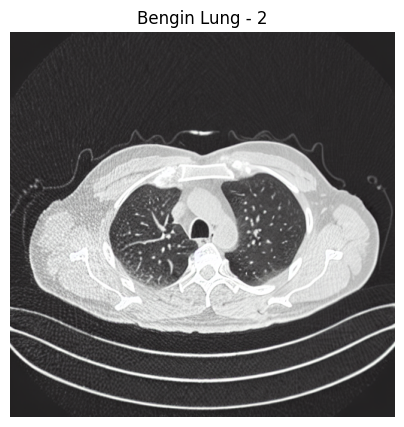

📸 Generating image 3/10 for bengin


  0%|          | 0/50 [00:00<?, ?it/s]

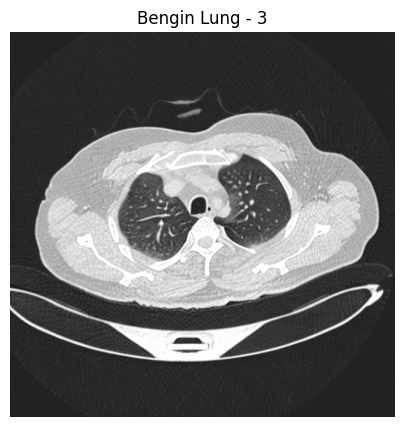

📸 Generating image 4/10 for bengin


  0%|          | 0/50 [00:00<?, ?it/s]

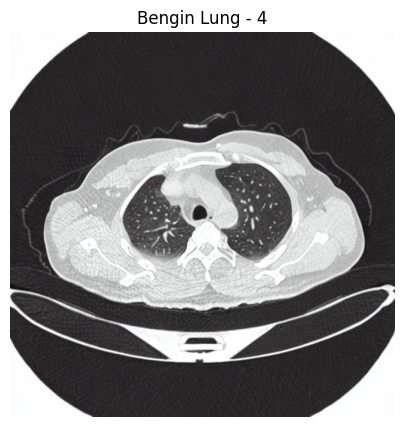

📸 Generating image 5/10 for bengin


  0%|          | 0/50 [00:00<?, ?it/s]

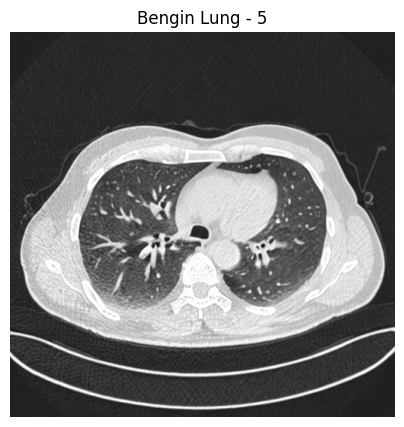

📸 Generating image 6/10 for bengin


  0%|          | 0/50 [00:00<?, ?it/s]

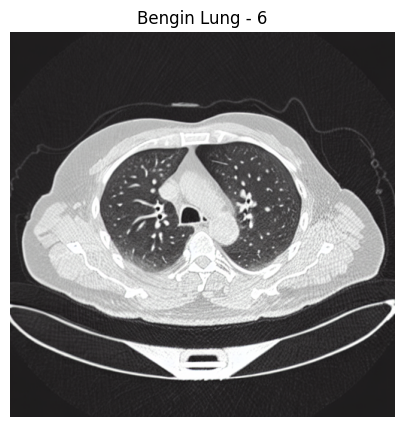

📸 Generating image 7/10 for bengin


  0%|          | 0/50 [00:00<?, ?it/s]

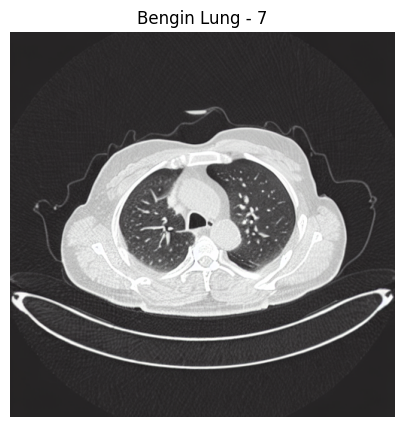

📸 Generating image 8/10 for bengin


  0%|          | 0/50 [00:00<?, ?it/s]

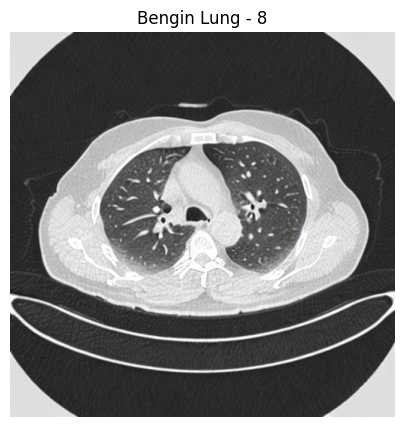

📸 Generating image 9/10 for bengin


  0%|          | 0/50 [00:00<?, ?it/s]

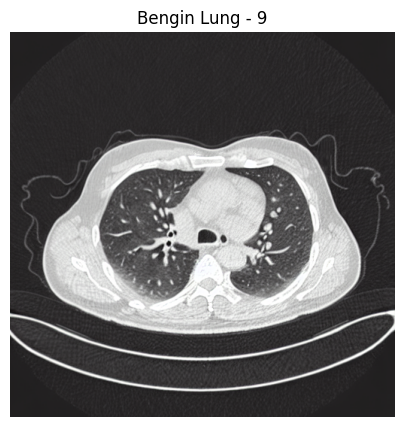

📸 Generating image 10/10 for bengin


  0%|          | 0/50 [00:00<?, ?it/s]

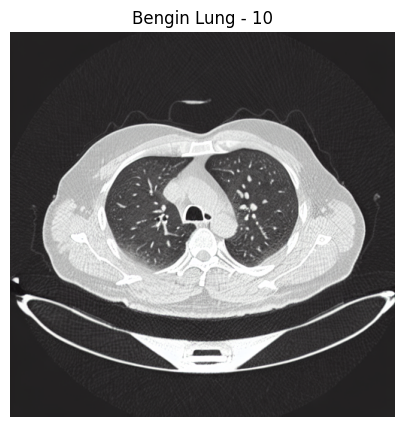


🔄 Applying LoRA model: malignant
📸 Generating image 1/10 for malignant


  0%|          | 0/50 [00:00<?, ?it/s]

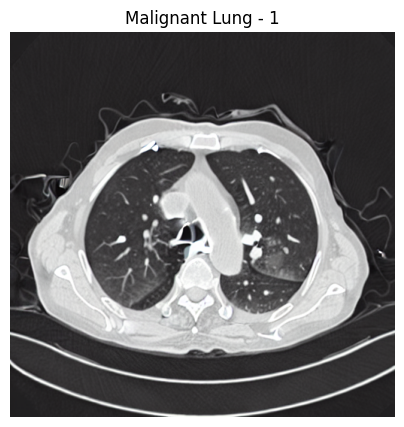

📸 Generating image 2/10 for malignant


  0%|          | 0/50 [00:00<?, ?it/s]

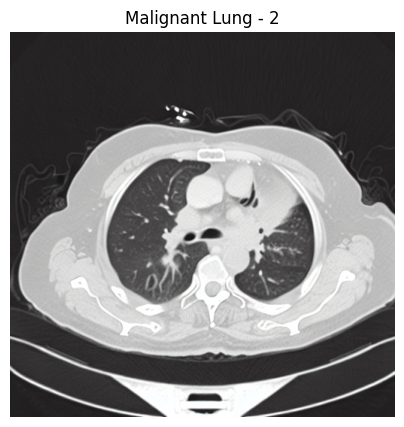

📸 Generating image 3/10 for malignant


  0%|          | 0/50 [00:00<?, ?it/s]

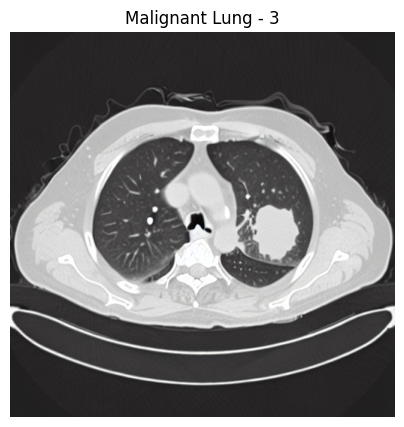

📸 Generating image 4/10 for malignant


  0%|          | 0/50 [00:00<?, ?it/s]

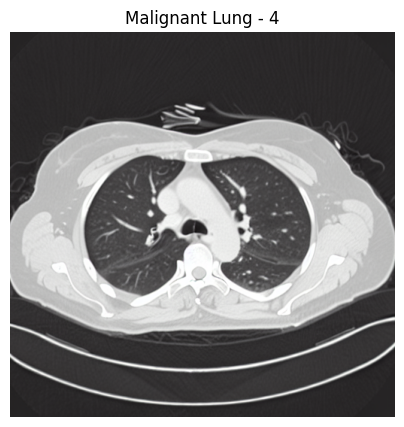

📸 Generating image 5/10 for malignant


  0%|          | 0/50 [00:00<?, ?it/s]

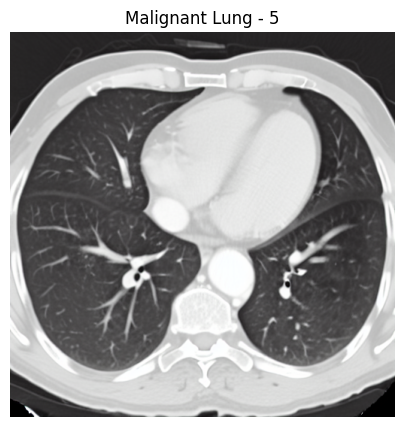

📸 Generating image 6/10 for malignant


  0%|          | 0/50 [00:00<?, ?it/s]

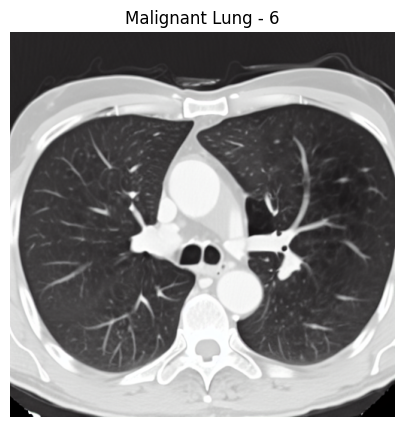

📸 Generating image 7/10 for malignant


  0%|          | 0/50 [00:00<?, ?it/s]

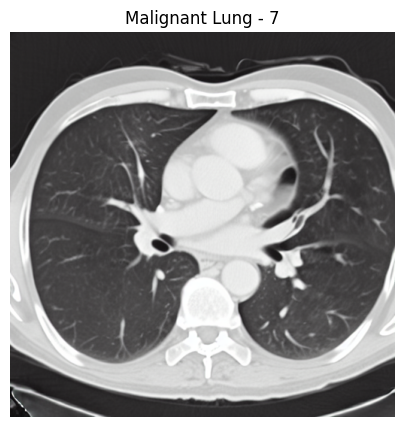

📸 Generating image 8/10 for malignant


  0%|          | 0/50 [00:00<?, ?it/s]

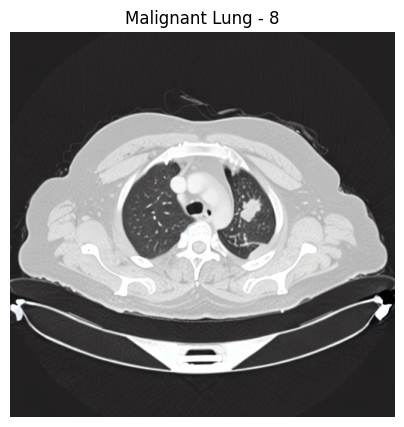

📸 Generating image 9/10 for malignant


  0%|          | 0/50 [00:00<?, ?it/s]

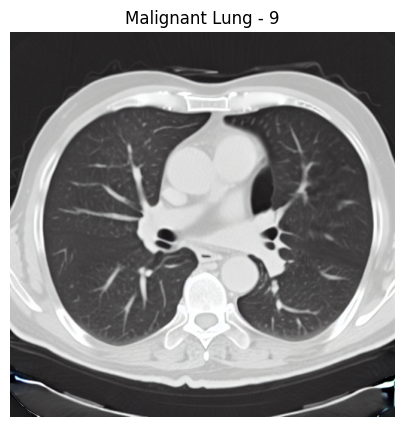

📸 Generating image 10/10 for malignant


  0%|          | 0/50 [00:00<?, ?it/s]

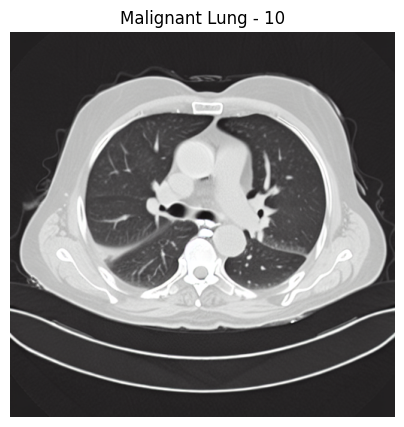

In [ ]:
import matplotlib.pyplot as plt
#Generates 10 images of each
for label, path in lora_paths.items():
    print(f"\n🔄 Applying LoRA model: {label}")
    pipe.unfuse_lora()
    apply_lora(pipe, path)

    prompt = prompts[label]

    for i in range(10):
        print(f"📸 Generating image {i+1}/10 for {label}")
        image = pipe(prompt, num_inference_steps=50, guidance_scale=5.5).images[0]

        # Show image
        plt.figure(figsize=(5, 5))
        plt.imshow(image)
        plt.axis("off")
        plt.title(f"{label.capitalize()} Lung - {i+1}")
        plt.show()


🔄 Applying LoRA model: healthy
📸 Generating image 1/10 for healthy


  0%|          | 0/50 [00:00<?, ?it/s]

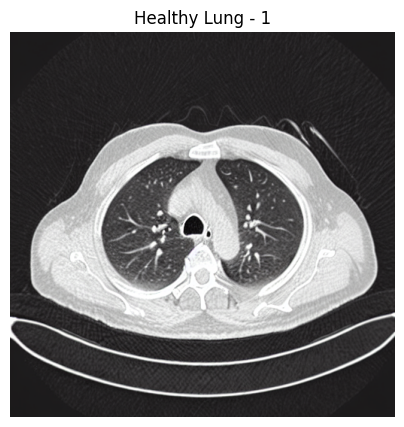

📸 Generating image 2/10 for healthy


  0%|          | 0/50 [00:00<?, ?it/s]

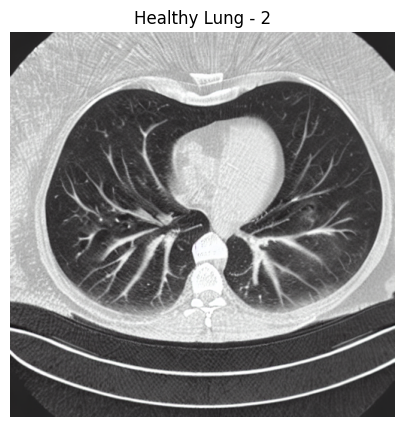

📸 Generating image 3/10 for healthy


  0%|          | 0/50 [00:00<?, ?it/s]

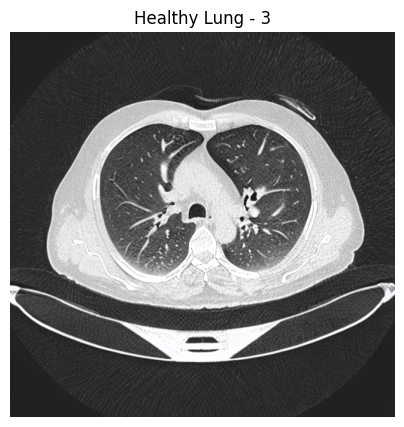

📸 Generating image 4/10 for healthy


  0%|          | 0/50 [00:00<?, ?it/s]

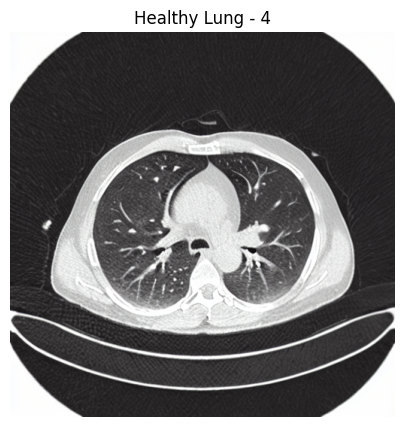

📸 Generating image 5/10 for healthy


  0%|          | 0/50 [00:00<?, ?it/s]

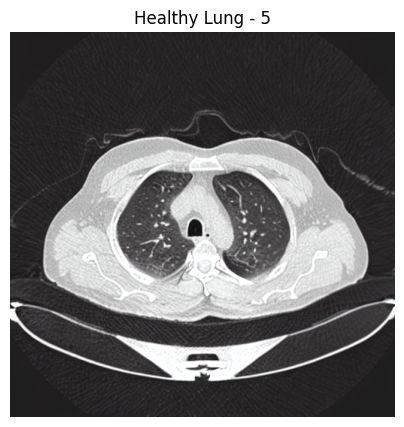

📸 Generating image 6/10 for healthy


  0%|          | 0/50 [00:00<?, ?it/s]

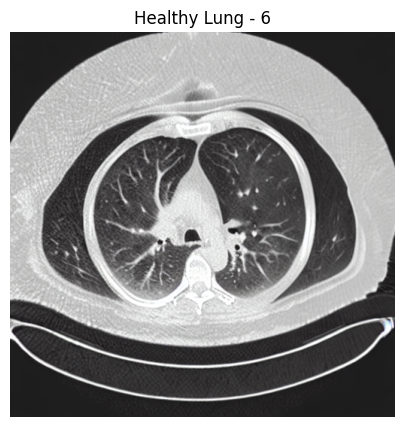

📸 Generating image 7/10 for healthy


  0%|          | 0/50 [00:00<?, ?it/s]

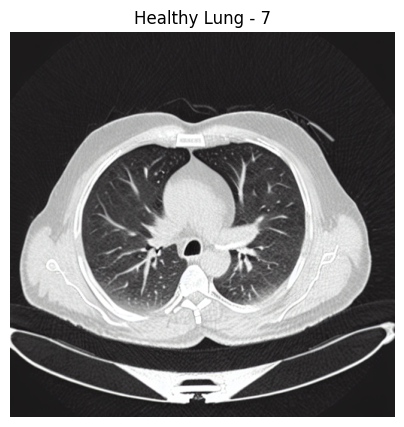

📸 Generating image 8/10 for healthy


  0%|          | 0/50 [00:00<?, ?it/s]

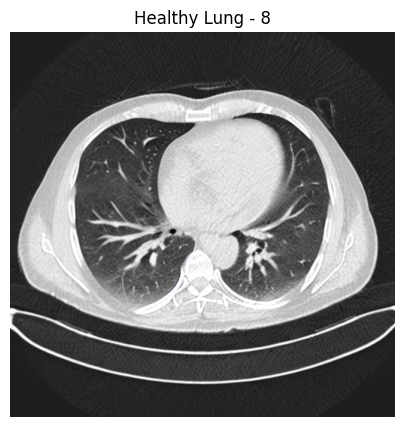

📸 Generating image 9/10 for healthy


  0%|          | 0/50 [00:00<?, ?it/s]

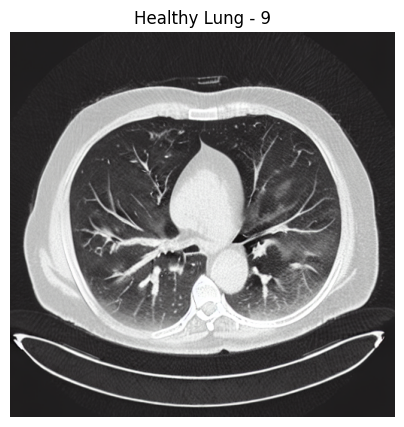

📸 Generating image 10/10 for healthy


  0%|          | 0/50 [00:00<?, ?it/s]

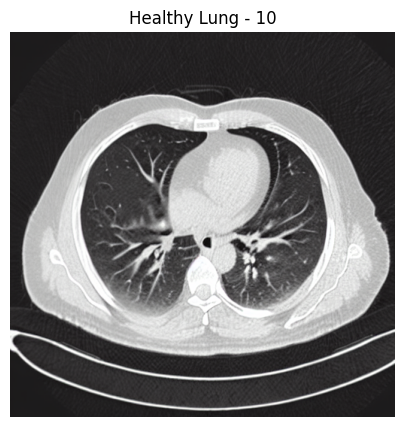


🔄 Applying LoRA model: bengin
📸 Generating image 1/10 for bengin


  0%|          | 0/50 [00:00<?, ?it/s]

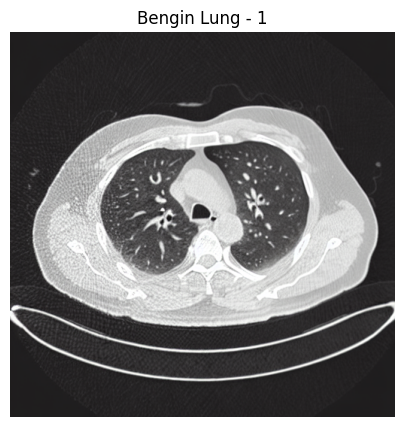

📸 Generating image 2/10 for bengin


  0%|          | 0/50 [00:00<?, ?it/s]

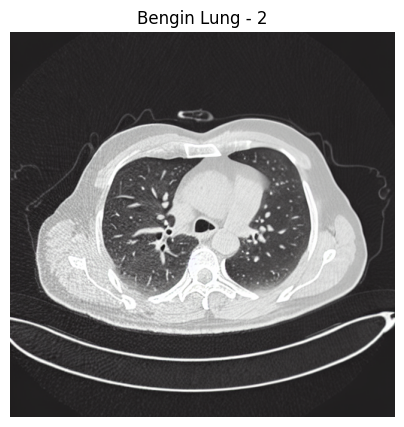

📸 Generating image 3/10 for bengin


  0%|          | 0/50 [00:00<?, ?it/s]

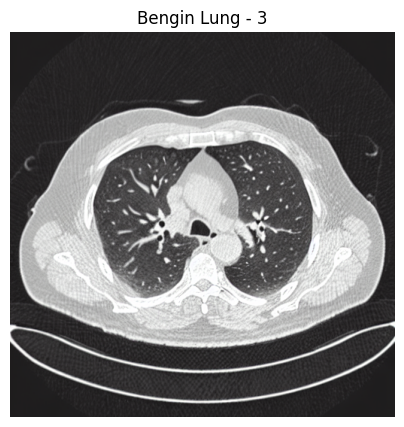

📸 Generating image 4/10 for bengin


  0%|          | 0/50 [00:00<?, ?it/s]

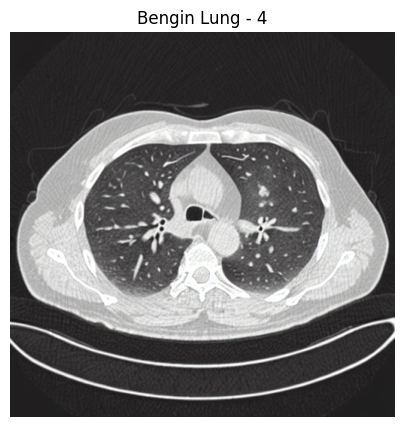

📸 Generating image 5/10 for bengin


  0%|          | 0/50 [00:00<?, ?it/s]

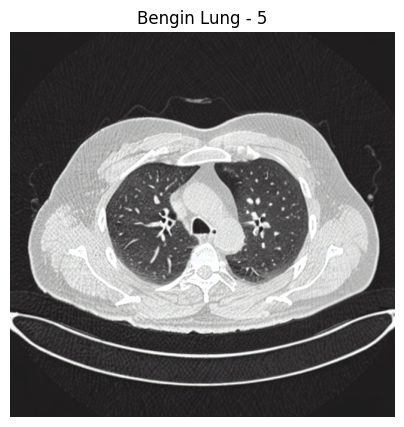

📸 Generating image 6/10 for bengin


  0%|          | 0/50 [00:00<?, ?it/s]

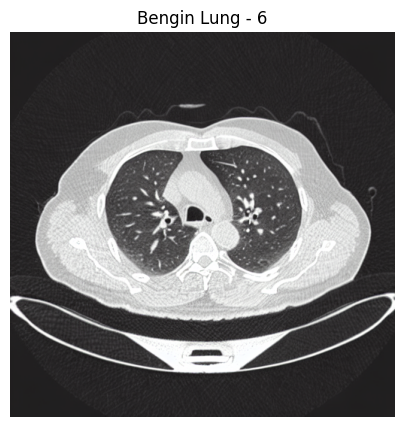

📸 Generating image 7/10 for bengin


  0%|          | 0/50 [00:00<?, ?it/s]

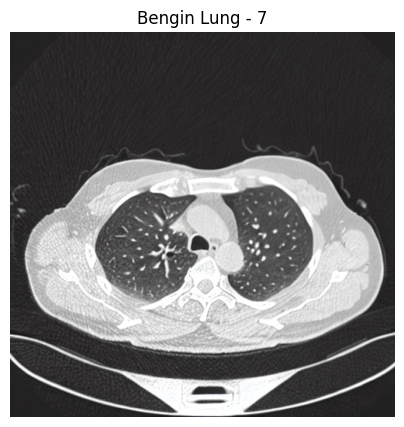

📸 Generating image 8/10 for bengin


  0%|          | 0/50 [00:00<?, ?it/s]

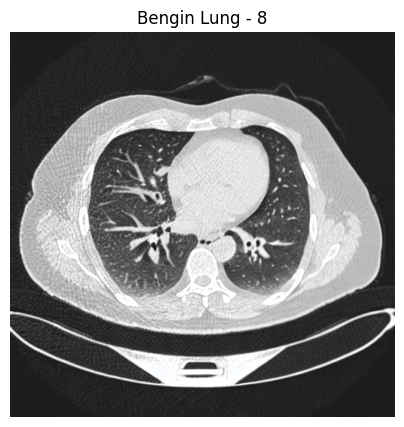

📸 Generating image 9/10 for bengin


  0%|          | 0/50 [00:00<?, ?it/s]

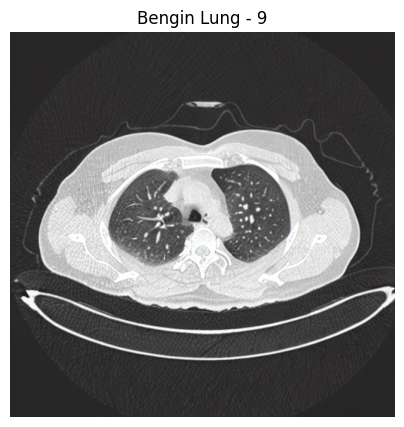

📸 Generating image 10/10 for bengin


  0%|          | 0/50 [00:00<?, ?it/s]

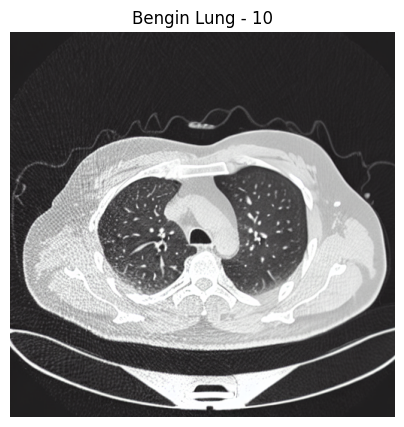


🔄 Applying LoRA model: malignant
📸 Generating image 1/10 for malignant


  0%|          | 0/50 [00:00<?, ?it/s]

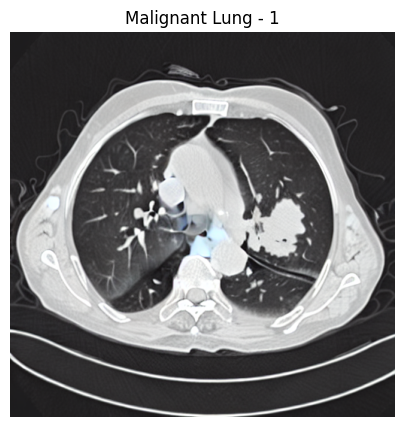

📸 Generating image 2/10 for malignant


  0%|          | 0/50 [00:00<?, ?it/s]

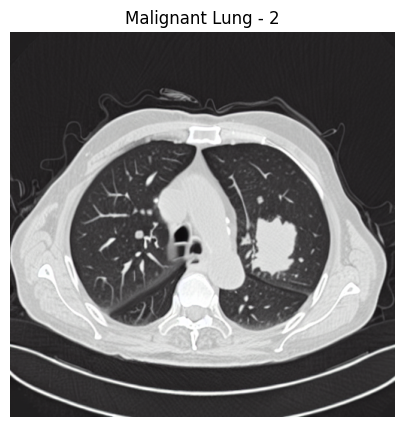

📸 Generating image 3/10 for malignant


  0%|          | 0/50 [00:00<?, ?it/s]

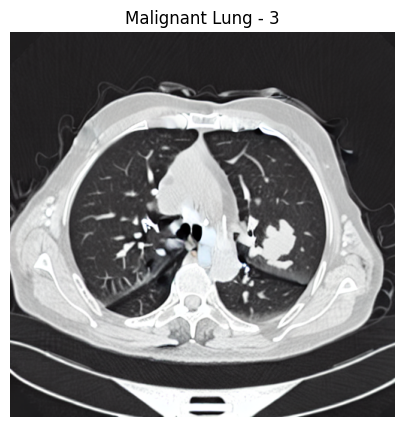

📸 Generating image 4/10 for malignant


  0%|          | 0/50 [00:00<?, ?it/s]

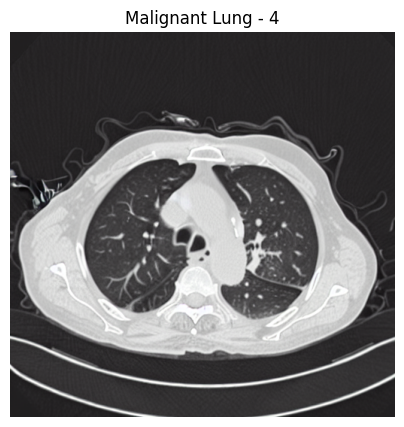

📸 Generating image 5/10 for malignant


  0%|          | 0/50 [00:00<?, ?it/s]

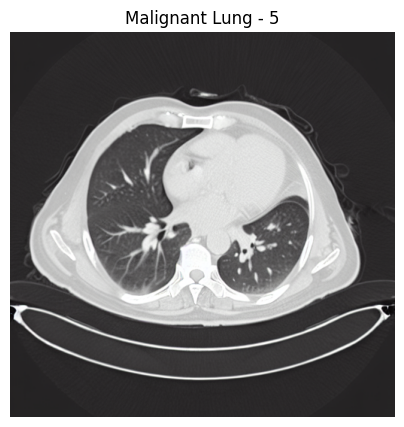

📸 Generating image 6/10 for malignant


  0%|          | 0/50 [00:00<?, ?it/s]

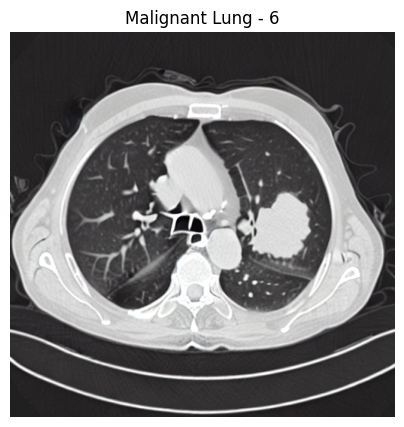

📸 Generating image 7/10 for malignant


  0%|          | 0/50 [00:00<?, ?it/s]

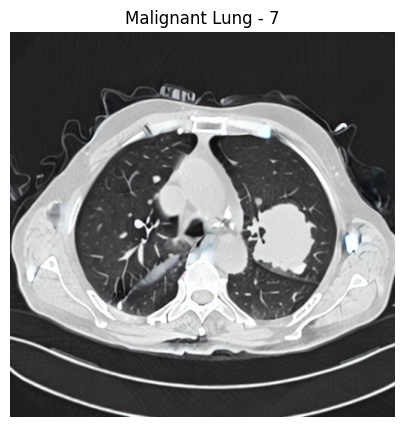

📸 Generating image 8/10 for malignant


  0%|          | 0/50 [00:00<?, ?it/s]

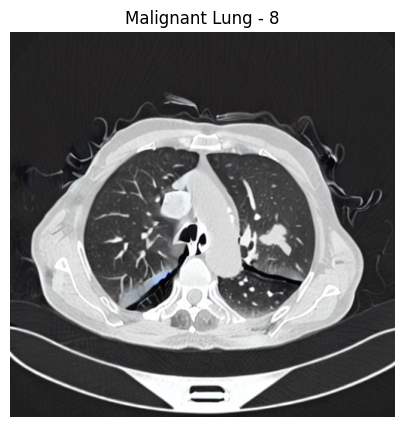

📸 Generating image 9/10 for malignant


  0%|          | 0/50 [00:00<?, ?it/s]

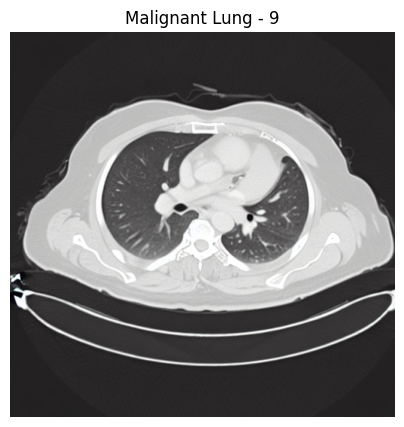

📸 Generating image 10/10 for malignant


  0%|          | 0/50 [00:00<?, ?it/s]

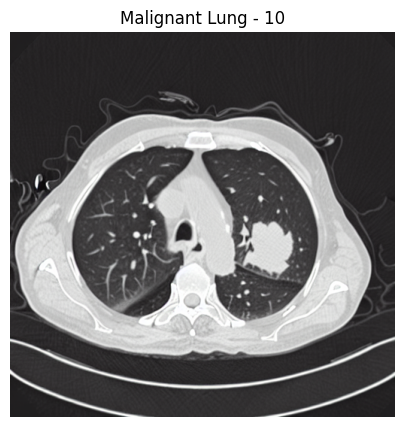

In [ ]:
import os
for label, path in lora_paths.items():
    print(f"\n🔄 Applying LoRA model: {label}")
    pipe.unfuse_lora()  # reset to base model
    apply_lora(pipe, path)

    # Create an output directory for this label
    os.makedirs(f"generated_images/{label}", exist_ok=True)

    prompt = prompts[label]

    for i in range(10):
        print(f"📸 Generating image {i+1}/10 for {label}")
        image = pipe(prompt, num_inference_steps=50, guidance_scale=5.5).images[0]

        # Save the image as PNG
        filename = f"{label}_{i+1}.png"
        save_path = os.path.join("generated_images", label, filename)
        image.save(save_path)

        # (Optional) If you still want to display the image inline:
        plt.figure(figsize=(5, 5))
        plt.imshow(image)
        plt.axis("off")
        plt.title(f"{label.capitalize()} Lung - {i+1}")
        plt.show()

In [ ]:

!cp -r generated_images /content/drive/MyDrive/
